In [132]:
from PIL import Image
import numpy as np
import pandas as pd
from pathlib import Path
import os
import matplotlib.pyplot as plt

In [133]:
import os
from glob import glob

files = []
start_dir = 'D:/TUD/TU_Dresden/WiSe_2021/Thesis_FZJ/ICIAR2018_BACH_Challenge/Photos/Normal'
pattern   = "*.tif"

for dir,_,_ in os.walk(start_dir):
    files.extend(glob(os.path.join(dir,pattern))) 

In [134]:
c=0
for img in files:
    if c%50==0:
        print(c)
    #image = Image.open(Path(train_image_path)/Path(data_train_csv['Image_name'][img]))
    image = Image.open(img)
    array_of_image_3d = np.asarray(image)
    crop_list_r = dict()
    crop_list_g = dict()
    crop_list_b = dict()
    cropsize = 512
    for channel in range(0,3,1):
        array_of_image = array_of_image_3d[:,:,channel]
        for i in range(0,3):
            for j in range(0,4):
                if channel == 0:
                    crop = array_of_image[i*cropsize:(cropsize+(cropsize*i)),(cropsize*j):(cropsize*(j+1))]
                    crop_list_r.update({f'{i}{j}':crop})
                elif channel==1:
                    crop = array_of_image[i*cropsize:(cropsize+(cropsize*i)),(cropsize*j):(cropsize*(j+1))]
                    crop_list_g.update({f'{i}{j}':crop})
                else:
                    crop = array_of_image[i*cropsize:(cropsize+(cropsize*i)),(cropsize*j):(cropsize*(j+1))]
                    crop_list_b.update({f'{i}{j}':crop})
    crop_list = {}
    for i in range(0,3):
        for j in range(0,4):
            a1 = Image.fromarray(crop_list_r[f'{i}{j}'],mode=None)
            a2 = Image.fromarray(crop_list_g[f'{i}{j}'],mode=None)
            a3 = Image.fromarray(crop_list_b[f'{i}{j}'],mode=None)
            merged = Image.merge("RGB", (a1, a2, a3))
            crop_list.update({f'{i}{j}':merged})
    for index,image_patch in enumerate(crop_list):
        crop_list[image_patch].save('D:/TUD/TU_Dresden/WiSe_2021/Thesis_FZJ/ICIAR2018_BACH_Challenge/Photos/crops/'+ img.split('/')[-1].split('\\')[-1][0:4] + '_' +image_patch + '_' +'.tif')
    c = c + 1

0
50


In [127]:
files[1]

'D:/TUD/TU_Dresden/WiSe_2021/Thesis_FZJ/ICIAR2018_BACH_Challenge/Photos/Invasive\\iv002.tif'

In [129]:
files[0].split('/')[-1].split('\\')[-1][0:5]

'iv001'

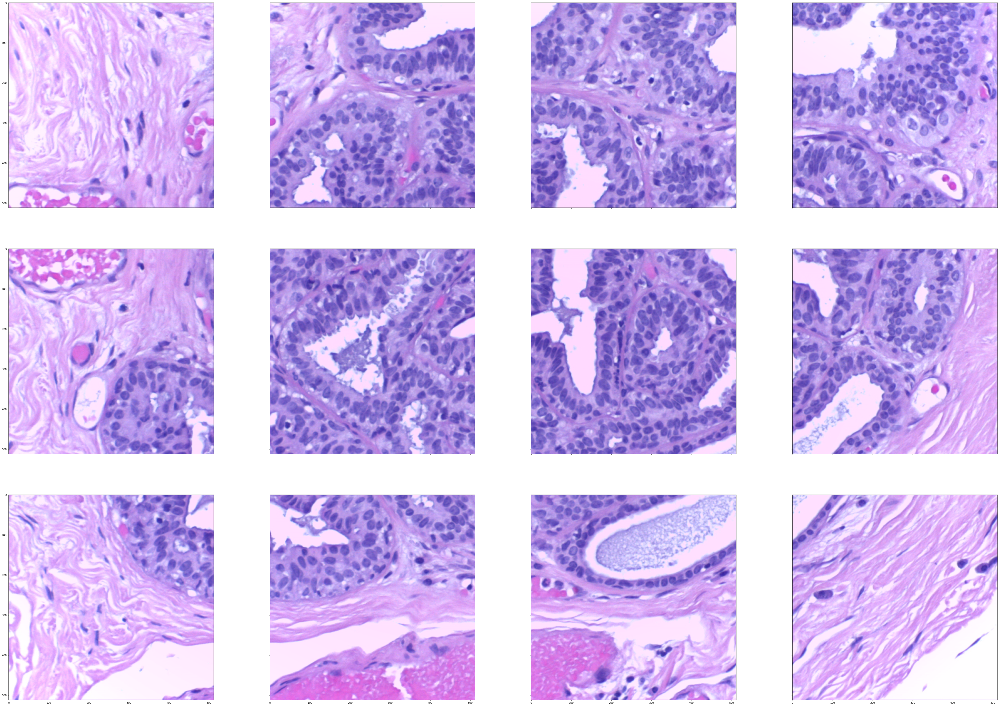

In [86]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(nrows=3, ncols=4, sharex=True, sharey=True,figsize = (70,50))
for i in range(0,3):
    for j in range(0,4):
        ax[i,j].imshow(crop_list[f'{i}{j}'])
#plt.subplots_adjust(wspace=0, hspace=0)
plt.savefig('ex.png')
plt.show()

In [ ]:
array_of_image.shape